# Preprocesamiento del maestro dataset

### Preprocesamiento de metadatos

El dataset viene con un archivo csv y un archivo json que traen metadatos, que no se si lo voy a usar, pero tiene estos datos:
- canonical_composer: Nombre del compositor
- canonical_title: Título de la pieza
- split: Conjunto de datos al que pertenece (train, validation, test)
- year: Año de la grabación
- midi_filename: Nombre del archivo MIDI
- audio_filename: Nombre del archivo de audio
- duration: Duración de la pieza en segundos

In [1]:
import pandas
import pandas as pd
import numpy as np
import pretty_midi
from torch.ao.nn.quantized.functional import clamp
from tqdm import tqdm
import os

In [2]:
# Procesamos los metadatos del dataset
def load_and_process_metadata(csv_path):
    # Cargar el CSV de metadatos
    df = pd.read_csv(csv_path)

    # Convertir compositores y títulos a categorías numéricas
    df['composer_id'] = pd.Categorical(df['canonical_composer']).codes
    df['title_id'] = pd.Categorical(df['canonical_title']).codes

    # Normalizar la duración
    df['duration_normalized'] = (df['duration'] - df['duration'].min()) / (df['duration'].max() - df['duration'].min())

    return df


metadata_df = pd.DataFrame(load_and_process_metadata('maestro-v3.0.0/maestro-v3.0.0.csv'))
metadata_df.head()

,canonical_composer,canonical_title,split,year,midi_filename,audio_filename,duration,composer_id,title_id,duration_normalized
0,Alban Berg,Sonata Op. 1,train,2018,2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R...,2018/MIDI-Unprocessed_Chamber3_MID--AUDIO_10_R...,698.661160,0,605,0.253345
1,Alban Berg,Sonata Op. 1,train,2008,2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MI...,2008/MIDI-Unprocessed_03_R2_2008_01-03_ORIG_MI...,759.518471,0,605,0.276938
2,Alban Berg,Sonata Op. 1,train,2017,2017/MIDI-Unprocessed_066_PIANO066_MID--AUDIO-...,2017/MIDI-Unprocessed_066_PIANO066_MID--AUDIO-...,464.649433,0,605,0.162626
3,Alexander Scriabin,"24 Preludes Op. 11, No. 13-24",train,2004,2004/MIDI-Unprocessed_XP_21_R1_2004_01_ORIG_MI...,2004/MIDI-Unprocessed_XP_21_R1_2004_01_ORIG_MI...,872.640588,1,15,0.320792
4,Alexander Scriabin,"3 Etudes, Op. 65",validation,2006,2006/MIDI-Unprocessed_17_R1_2006_01-06_ORIG_MI...,2006/MIDI-Unprocessed_17_R1_2006_01-06_ORIG_MI...,397.857508,1,17,0.136732


### Preprocesamiento de archivos MIDI

Convertimos los archivos MIDI en una representación numérica que podamos usar para entrenar un modelo.

In [3]:
def midi_to_piano_roll(midi_path, fs=100, segment_length=30):
    """
    Convierte un archivo MIDI a una representación de piano roll.
    """
    midi_data = pretty_midi.PrettyMIDI(midi_path)
    total_frames = int(midi_data.get_end_time() * fs)

    # Limitar las notas al rango de un piano (notas entre A0 y C8)
    piano_roll = np.zeros((88, total_frames),
                          dtype=np.float32)  # Cambiar a 88 notas (rango de un piano) en lugar de 128

    for instrument in midi_data.instruments:
        if not instrument.is_drum:
            for note in instrument.notes:
                if 21 <= note.pitch <= 108:  # Filtrar por rango de notas de piano
                    start = int(note.start * fs)
                    end = int(note.end * fs)
                    piano_roll[note.pitch - 21, start:end] = note.velocity / 127.0  # Normalizar a [0, 1]

    segment_frames = int(segment_length * fs)
    segments = []
    for start in range(0, total_frames, segment_frames):
        end = start + segment_frames
        if end > total_frames:
            # Rellenar con ceros si el segmento excede la duración total
            segment = np.zeros((88, segment_frames), dtype=np.float32)
            segment[:, :total_frames - start] = piano_roll[:, start:]
        else:
            segment = piano_roll[:, start:end]
        segments.append(segment)

    return segments


In [4]:
def create_var_dataset_single_year(metadata_df, root_dir, output_dir, year, segment_length=30, fs=100):
    """
    Crea un dataset de piano roll para un año específico del Maestro Dataset.
    """
    print(f"Procesando año {year}")
    year_df = metadata_df[metadata_df['year'] == year]
    print(f"Número de archivos para el año {year}: {len(year_df)}")

    composer_categories = pd.Categorical(metadata_df['canonical_composer'])
    composer_codes = {composer: code for code, composer in enumerate(composer_categories.categories)}
    split_categories = pd.Categorical(metadata_df['split'])
    split_codes = {split: code for code, split in enumerate(split_categories.categories)}

    os.makedirs(output_dir, exist_ok=True)
    output_path = os.path.join(output_dir, f'maestro_var_dataset_{year}.npz')

    piano_rolls = []
    metadata_features = []

    for index, row in tqdm(year_df.iterrows(), total=len(year_df), desc=f"Procesando archivos MIDI de {year}"):
        midi_path = os.path.join(root_dir, row['midi_filename'])

        if not os.path.exists(midi_path):
            print(f"Archivo MIDI no encontrado: {midi_path}")
            continue

        try:
            piano_roll_segments = midi_to_piano_roll(midi_path, fs=fs, segment_length=segment_length)

            if not piano_roll_segments:
                print(f"No se obtuvieron segmentos para: {midi_path}")
                continue

            metadata_feature = np.array([
                row['year'],
                composer_codes[row['canonical_composer']],
                split_codes[row['split']]
            ], dtype=np.int16)

            piano_rolls.extend(piano_roll_segments)
            metadata_features.extend([metadata_feature] * len(piano_roll_segments))

        except Exception as e:
            print(f"Error procesando {midi_path}: {str(e)}")

    if not piano_rolls:
        raise ValueError(f"No se procesó ningún archivo MIDI correctamente para el año {year}.")

    piano_rolls = np.array(piano_rolls, dtype=np.float32)
    metadata_features = np.array(metadata_features, dtype=np.int16)

    print(f"Forma final del piano roll: {piano_rolls.shape}")
    print(f"Forma final de las características de metadatos: {metadata_features.shape}")

    try:
        np.savez_compressed(
            output_path,
            piano_rolls=piano_rolls,
            metadata_features=metadata_features
        )
        print(f"Dataset del año {year} guardado en {output_path}")
        print(f"Tamaño del archivo: {os.path.getsize(output_path) / (1024 * 1024):.2f} MB")
    except Exception as e:
        print(f"Error al guardar el dataset: {str(e)}")

In [5]:
root_dir = 'maestro-v3.0.0'
output_path = 'maestro-v3.0.0/pre_processed_ds'

# Vamos a samplear 5 frames por segundo, porque 100 frames es mucho
# Vamos a tener fragmentos de 5 segundos, de 5 frames por segundo y 88 posibles notas, entonces el tamaño de la matriz es 5*5*88 = 2200
create_var_dataset_single_year(metadata_df, root_dir, output_path, 2004, segment_length=5, fs=5)

Procesando año 2004
Número de archivos para el año 2004: 132


Procesando archivos MIDI de 2004: 100%|██████████| 132/132 [00:25<00:00,  5.27it/s]


Forma final del piano roll: (16765, 88, 25)
Forma final de las características de metadatos: (16765, 3)
Dataset del año 2004 guardado en maestro-v3.0.0/pre_processed_ds/maestro_var_dataset_2004.npz
Tamaño del archivo: 2.12 MB


### Vamos a guardar una muestra en un archivo MIDI para verificar que podemos guardarlo cuando generemos música con el autoencoder

In [2]:
def piano_roll_to_midi(piano_roll, fs=5, output_path='output.mid'):
    """
    Convierte un piano roll a un archivo MIDI.
    """
    midi_data = pretty_midi.PrettyMIDI()
    instrument = pretty_midi.Instrument(program=0)  # Instrumento piano

    # Para cada nota en el rango del piano (88 notas)
    for note_index in range(piano_roll.shape[0]):
        # Encontrar los intervalos donde la nota está activa
        note_events = np.where(piano_roll[note_index, :] > 0)[0]

        if len(note_events) == 0:
            continue

        # Agrupar las activaciones de notas en eventos de nota continua
        current_note_start = note_events[0]
        for i in range(1, len(note_events)):
            if note_events[i] != note_events[i - 1] + 1:
                # Finalizar la nota anterior y comenzar una nueva
                note = pretty_midi.Note(
                    velocity=int(piano_roll[note_index, current_note_start] * 127),
                    pitch=note_index + 21,  # 21 es A0
                    start=current_note_start / fs,
                    end=note_events[i - 1] / fs
                )
                instrument.notes.append(note)
                current_note_start = note_events[i]

        # Añadir la última nota
        note = pretty_midi.Note(
            velocity=int(piano_roll[note_index, current_note_start] * 127),
            pitch=note_index + 21,  # 21 es A0
            start=current_note_start / fs,
            end=note_events[-1] / fs
        )
        instrument.notes.append(note)

    midi_data.instruments.append(instrument)
    midi_data.write(output_path)
    print(f"Archivo MIDI guardado en {output_path}")

In [7]:
# Cargar el dataset generado
dataset = np.load('maestro-v3.0.0/pre_processed_ds/maestro_var_dataset_2004.npz')
piano_rolls = dataset['piano_rolls']
metadata_features = dataset['metadata_features']

# Tomar la primera muestra
first_sample = piano_rolls[0]

print(first_sample.shape)

# Convertir la primera muestra de piano roll a MIDI
piano_roll_to_midi(first_sample, fs=5, output_path='output/first_sample_output.mid')

(88, 25)
Archivo MIDI guardado en output/first_sample_output.mid


In [8]:
# Reproducirlo, primero instalar timidity en el sistema
os.system("timidity output/first_sample_output.mid -Ow -o output/first_sample_output.wav")

Playing output/first_sample_output.mid
MIDI file: output/first_sample_output.mid
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~7 seconds
Notes cut: 0
Notes lost totally: 0


0

In [9]:
from IPython.display import Audio

# Reproducir el archivo WAV
Audio('output/first_sample_output.wav')

# Autoencoder

In [3]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset, Dataset, random_split
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import gc

In [4]:
# Configurar el dispositivo (GPU si está disponible, de lo contrario CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

Usando dispositivo: cuda


#### Exploramos un poquito el dataset

In [5]:
# Función para cargar el dataset generado
def load_dataset(path):
    data = np.load(path)
    piano_rolls = data['piano_rolls']
    # El tamaño del piano_roll es (número de muestras, 88 * 5 * 5)
    piano_rolls = piano_rolls.reshape(piano_rolls.shape[0], -1)
    print(f"Forma del dataset: {piano_rolls.shape}")
    return torch.tensor(piano_rolls, dtype=torch.float32)

In [6]:
# Tamaño del lote
batch_size = 32

# Cargar el dataset
dataset_path = 'maestro-v3.0.0/pre_processed_ds/maestro_var_dataset_2004.npz'
piano_roll_data = load_dataset(dataset_path)

# Dividir en conjunto de entrenamiento y validación (80% entrenamiento, 20% validación)
train_size = int(0.8 * len(piano_roll_data))
val_size = len(piano_roll_data) - train_size
train_dataset, val_dataset = random_split(piano_roll_data, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

Forma del dataset: (16765, 2200)


In [14]:
# Vamos a samplear 5 frames por segundo, porque 100 frames es mucho
# Vamos a tener fragmentos de 5 segundos, de 5 frames por segundo y 88 posibles notas, entonces el tamaño de la matriz es 5*5*88 = 2200
piano_roll_data

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]])

Nuestra matriz original es de 2200 elementos, porque tenemos 5 segundos de música, con 5 frames por segundo y 88 posibles notas. Esto nos da 2200 elementos, que es la cantidad de columnas que tenemos.
Por otro lado, tenemos 16765 filas, entonces tenemos 16765 muestras de 5 segundos cada una

In [15]:
display(piano_roll_data.max(), piano_roll_data.min())

tensor(0.9606)

tensor(0.)

Como vemos, los datos están normalizados, entre 0 y 1. En los archivos a producir, vamos a buscar que los datos también esten normalizados

### Autoencoder

Ahora sí, generamos un encoder, un decoder y juntamos todo en un autoencoder.

La razón de usar un autoencoder es que queremos reducir la dimensionalidad de los datos, para poder generar música a partir de una representación más simple.

A su vez, queremos ingresar ruido al decoder y que este genere música.

In [16]:
class Encoder(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(Encoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_size, 1024),
            nn.ReLU(),
            nn.Linear(1024, hidden_size),
            nn.ReLU(),
        )

    def forward(self, x):
        return self.encoder(x)

In [17]:
class Decoder(nn.Module):
    def __init__(self, hidden_size, output_size):
        super(Decoder, self).__init__()
        self.decoder = nn.Sequential(
            nn.Linear(hidden_size, 1024),
            nn.ReLU(),
            nn.Linear(1024, output_size),
            # nn.ReLU() # Opción sin activación para salida no limitada
            # nn.Sigmoid()  # Normalizamos la salida en un rango [0, 1]
            nn.Identity()  # Identity
        )

    def forward(self, x):
        return torch.clamp(self.decoder(x), min=0, max=1)  # Clipping para mantener los valores entre 0 y 1
        # return self.decoder(x)

In [18]:
class Autoencoder(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(Autoencoder, self).__init__()
        self.encoder = Encoder(input_size, hidden_size)
        self.decoder = Decoder(hidden_size, output_size)

    def forward(self, x):
        latent_space = self.encoder(x)
        reconstruction = self.decoder(latent_space)
        return reconstruction

In [19]:
# Parámetros
input_size = 88 * 5 * 5
hidden_size = 512
output_size = input_size
batch_size = 32
epochs = 100
learning_rate = 0.001

# Cargar el dataset
dataset_path = 'maestro-v3.0.0/pre_processed_ds/maestro_var_dataset_2004.npz'
piano_roll_data = load_dataset(dataset_path)

# Dividir en conjunto de entrenamiento y validación (80% entrenamiento, 20% validación)
train_size = int(0.8 * len(piano_roll_data))
val_size = len(piano_roll_data) - train_size
train_dataset, val_dataset = random_split(piano_roll_data, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

Forma del dataset: (16765, 2200)


In [20]:
# Inicializar modelo, optimizador y criterio de pérdida
autoencoder = Autoencoder(input_size=input_size, hidden_size=hidden_size, output_size=output_size).to(device)
optimizer = optim.Adam(autoencoder.parameters(), lr=learning_rate)
criterion = nn.MSELoss()

# Para guardar el loss por epoch
train_losses = []
val_losses = []


# Función para validar el modelo en el conjunto de validación
def validate_model(model, val_loader, criterion):
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for batch in val_loader:
            inputs = batch.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, inputs)
            val_loss += loss.item()
    return val_loss / len(val_loader)


# Entrenamiento del autoencoder con early stopping
for epoch in range(epochs):
    autoencoder.train()
    total_train_loss = 0

    for batch in train_loader:
        inputs = batch.to(device)

        # Forward pass
        outputs = autoencoder(inputs)
        loss = criterion(outputs, inputs)

        # Backward pass y optimización
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_train_loss += loss.item()

    # Calcular loss en el conjunto de validación
    val_loss = validate_model(autoencoder, val_loader, criterion)

    # Promediar las pérdidas
    avg_train_loss = total_train_loss / len(train_loader)
    avg_val_loss = val_loss

    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f'Epoch [{epoch + 1}/{epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}')

# Guardar el modelo final entrenado
torch.save(autoencoder, 'models/autoencoder_final.pth')
print("Entrenamiento finalizado. Modelo guardado.")


Epoch [1/100], Train Loss: 0.0048, Val Loss: 0.0046
Epoch [2/100], Train Loss: 0.0044, Val Loss: 0.0044
Epoch [3/100], Train Loss: 0.0041, Val Loss: 0.0043
Epoch [4/100], Train Loss: 0.0039, Val Loss: 0.0042
Epoch [5/100], Train Loss: 0.0038, Val Loss: 0.0042
Epoch [6/100], Train Loss: 0.0037, Val Loss: 0.0041
Epoch [7/100], Train Loss: 0.0036, Val Loss: 0.0041
Epoch [8/100], Train Loss: 0.0035, Val Loss: 0.0041
Epoch [9/100], Train Loss: 0.0035, Val Loss: 0.0041
Epoch [10/100], Train Loss: 0.0034, Val Loss: 0.0041
Epoch [11/100], Train Loss: 0.0034, Val Loss: 0.0041
Epoch [12/100], Train Loss: 0.0033, Val Loss: 0.0041
Epoch [13/100], Train Loss: 0.0033, Val Loss: 0.0041
Epoch [14/100], Train Loss: 0.0033, Val Loss: 0.0041
Epoch [15/100], Train Loss: 0.0033, Val Loss: 0.0041
Epoch [16/100], Train Loss: 0.0033, Val Loss: 0.0041
Epoch [17/100], Train Loss: 0.0032, Val Loss: 0.0041
Epoch [18/100], Train Loss: 0.0032, Val Loss: 0.0041
Epoch [19/100], Train Loss: 0.0032, Val Loss: 0.0041
Ep

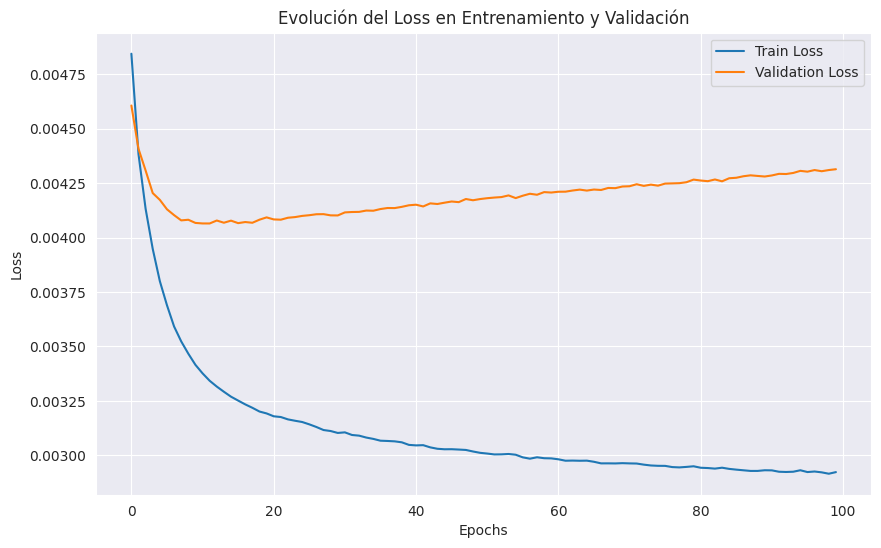

In [21]:
# Graficar las pérdidas de entrenamiento y validación
plt.figure(figsize=(10, 6))
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Evolución del Loss en Entrenamiento y Validación')
plt.show()

### Probamos el autoencoder

In [22]:
# Visualizar una muestra original y reconstruida
with torch.inference_mode():
    sample = next(iter(train_loader))[0].to(device)
    reconstructed = autoencoder(sample)

    original = sample.cpu().numpy()
    reconstructed = reconstructed.cpu().numpy()

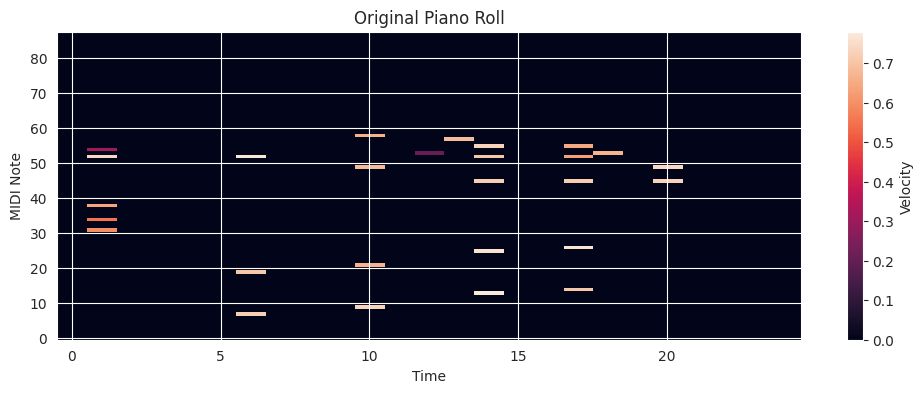

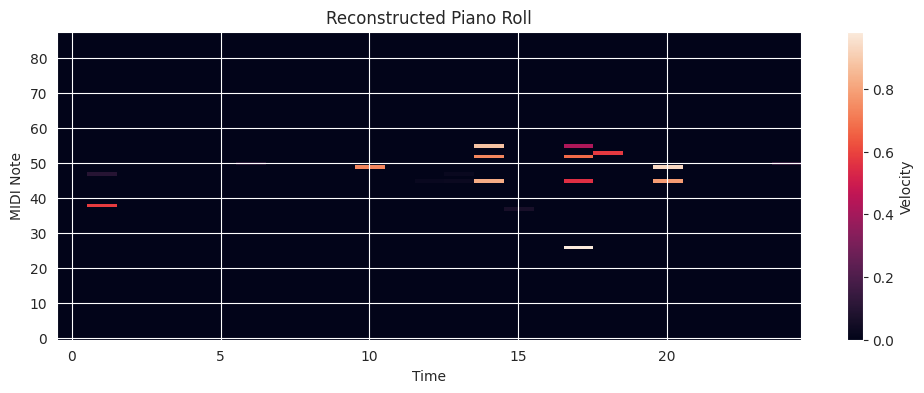

In [23]:
# Función para visualizar un piano roll
def visualize_piano_roll(piano_roll, title):
    plt.figure(figsize=(12, 4))
    plt.imshow(piano_roll.reshape(88, -1), aspect='auto', origin='lower')
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('MIDI Note')
    plt.colorbar(label='Velocity')
    plt.show()


visualize_piano_roll(original, 'Original Piano Roll')
visualize_piano_roll(reconstructed, 'Reconstructed Piano Roll')

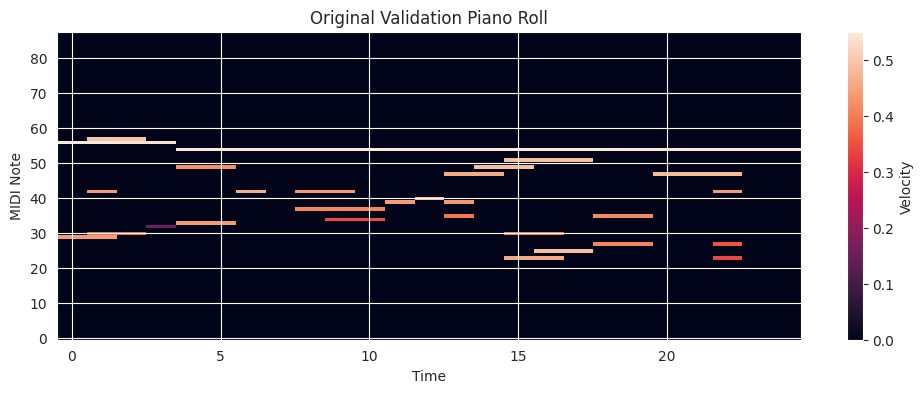

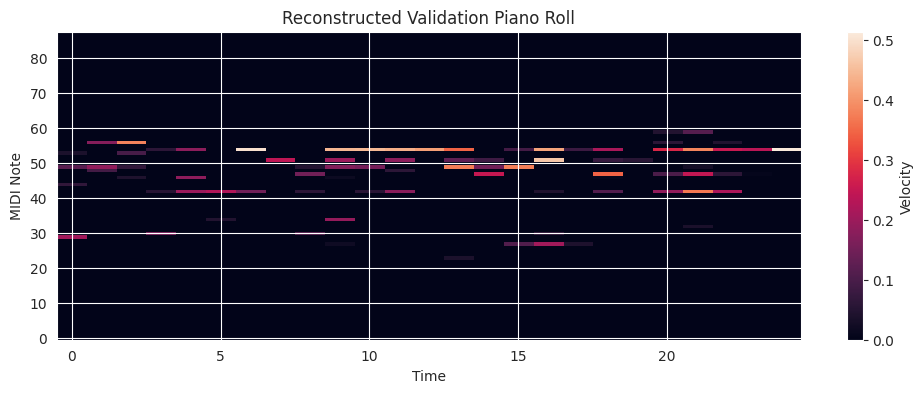

In [24]:
# Visualizar una muestra original y reconstruida
with torch.inference_mode():
    sample = next(iter(val_loader))[0].to(device)
    reconstructed = autoencoder(sample)

    original = sample.cpu().numpy()
    reconstructed = reconstructed.cpu().numpy()

visualize_piano_roll(original, 'Original Validation Piano Roll')
visualize_piano_roll(reconstructed, 'Reconstructed Validation Piano Roll')

In [25]:
(reconstructed.min(), reconstructed.max())

(np.float32(0.0), np.float32(0.514067))

### Generamos música

#### Generamos música a partir del dataset de entrenamiento

In [35]:
with torch.inference_mode():
    sample = next(iter(train_loader))[0].to(device)
    reconstructed = autoencoder(sample)

    original = sample.cpu().numpy()
    reconstructed = reconstructed.cpu().numpy()

In [36]:
original = original.reshape(88, -1)
reconstructed = reconstructed.reshape(88, -1)

In [37]:
original_name = "train_original"
reconstructed_name = "train_reconstructed"

# Convertir la primera muestra de piano roll a MIDI
piano_roll_to_midi(original, fs=5, output_path=f"output/{original_name}.midi")
piano_roll_to_midi(reconstructed, fs=5, output_path=f"output/{reconstructed_name}.midi")

Archivo MIDI guardado en output/train_original.midi
Archivo MIDI guardado en output/train_reconstructed.midi


In [38]:
from IPython.display import Audio

# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{original_name}.midi -Ow -o output/{original_name}.wav")

# Reproducir el archivo WAV
Audio(f"output/{original_name}.wav")

Playing output/train_original.midi
MIDI file: output/train_original.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


In [39]:
os.system(f"timidity output/{reconstructed_name}.midi -Ow -o output/{reconstructed_name}.wav")

# Reproducir el archivo WAV
Audio(f'output/{reconstructed_name}.wav')

Playing output/train_reconstructed.midi
MIDI file: output/train_reconstructed.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


#### Generamos música a partir del dataset de validacion

In [41]:
with torch.inference_mode():
    sample = next(iter(val_loader))[0].to(device)
    reconstructed = autoencoder(sample)

    original = sample.cpu().numpy()
    reconstructed = reconstructed.cpu().numpy()

In [42]:
original = original.reshape(88, -1)
reconstructed = reconstructed.reshape(88, -1)

In [43]:
original_name = "val_original"
reconstructed_name = "val_reconstructed"

# Convertir la primera muestra de piano roll a MIDI
piano_roll_to_midi(original, fs=5, output_path=f"output/{original_name}.midi")
piano_roll_to_midi(reconstructed, fs=5, output_path=f"output/{reconstructed_name}.midi")

Archivo MIDI guardado en output/val_original.midi
Archivo MIDI guardado en output/val_reconstructed.midi


In [44]:
from IPython.display import Audio

# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{original_name}.midi -Ow -o output/{original_name}.wav")

# Reproducir el archivo WAV
Audio(f"output/{original_name}.wav")

Playing output/val_original.midi
MIDI file: output/val_original.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


In [45]:
os.system(f"timidity output/{reconstructed_name}.midi -Ow -o output/{reconstructed_name}.wav")

# Reproducir el archivo WAV
Audio(f'output/{reconstructed_name}.wav')

Playing output/val_reconstructed.midi
MIDI file: output/val_reconstructed.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


#### Generamos música a partir de ruido

In [51]:
# Generar ruido aleatorio (latent space)
def generate_noise(batch_size, hidden_size):
    return torch.randn(batch_size, hidden_size).to(device)


# Inicializar solo el decoder
decoder = Decoder(hidden_size=hidden_size, output_size=output_size).to(device)

# Generar música a partir del ruido
noise = generate_noise(batch_size=1, hidden_size=hidden_size)  # Usamos batch_size=1 para generar una muestra
with torch.inference_mode():
    generated_piano_roll = decoder(noise)

# Convertir el piano roll generado en formato de numpy para guardarlo como MIDI
generated_piano_roll = generated_piano_roll.cpu().numpy().reshape(88, -1)  # Asegúrate de darle la forma correcta

generated_piano_roll

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.09272373],
       [0.09346835, 0.        , 0.18541202, ..., 0.        , 0.00742615,
        0.00139181],
       [0.        , 0.23634408, 0.05443441, ..., 0.19888458, 0.06458054,
        0.06819677],
       ...,
       [0.        , 0.07076751, 0.16490936, ..., 0.33409947, 0.07467443,
        0.        ],
       [0.        , 0.29849622, 0.        , ..., 0.19557495, 0.        ,
        0.09689061],
       [0.2125628 , 0.06891898, 0.        , ..., 0.35551763, 0.01941634,
        0.10934156]], dtype=float32)

In [53]:
for i in range(5):
    # Nombre del archivo de salida generado
    generated_name = f"generated_from_noise_{i}"

    # Convertir el piano roll generado a MIDI
    piano_roll_to_midi(generated_piano_roll, fs=5, output_path=f"output/{generated_name}.midi")

    # Reproducir el archivo MIDI generado
    os.system(f"timidity output/{generated_name}.midi -Ow -o output/{generated_name}.wav")

    # Reproducir el archivo WAV generado
    display(Audio(f'output/{generated_name}.wav'))

Archivo MIDI guardado en output/generated_from_noise_0.midi
Playing output/generated_from_noise_0.midi
MIDI file: output/generated_from_noise_0.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 7
Notes lost totally: 0


Archivo MIDI guardado en output/generated_from_noise_1.midi
Playing output/generated_from_noise_1.midi
MIDI file: output/generated_from_noise_1.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 7
Notes lost totally: 0


Archivo MIDI guardado en output/generated_from_noise_2.midi
Playing output/generated_from_noise_2.midi
MIDI file: output/generated_from_noise_2.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 7
Notes lost totally: 0


Archivo MIDI guardado en output/generated_from_noise_3.midi
Playing output/generated_from_noise_3.midi
MIDI file: output/generated_from_noise_3.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 7
Notes lost totally: 0


Archivo MIDI guardado en output/generated_from_noise_4.midi
Playing output/generated_from_noise_4.midi
MIDI file: output/generated_from_noise_4.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 7
Notes lost totally: 0


#### Generamos música a partir de algo de ruido en una muestra de entrenamiento

In [65]:
# Función para agregar ruido a una muestra de entrenamiento
def add_noise_to_sample(sample, noise_factor=0.1):
    noise = torch.randn_like(sample) * noise_factor
    noisy_sample = sample + noise
    return torch.clamp(noisy_sample, 0, 1)  # Mantener los valores entre 0 y 1

In [66]:
sample = next(iter(train_loader))[0].to(device)
noisy_sample = add_noise_to_sample(sample)

In [67]:
with torch.inference_mode():
    reconstructed = autoencoder(noisy_sample)
    reconstructed = reconstructed.cpu().numpy()

In [68]:
original_name = "train_noise_original"
reconstructed_name = "train_noise_reconstructed"

sample = sample.cpu().reshape(88, -1)
reconstructed = reconstructed.reshape(88, -1)

# Convertir la primera muestra de piano roll a MIDI
piano_roll_to_midi(sample, fs=5, output_path=f"output/{original_name}.midi")
piano_roll_to_midi(reconstructed, fs=5, output_path=f"output/{reconstructed_name}.midi")

Archivo MIDI guardado en output/train_noise_original.midi
Archivo MIDI guardado en output/train_noise_reconstructed.midi


In [69]:
# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{original_name}.midi -Ow -o output/{original_name}.wav")

# Reproducir el archivo WAV
Audio(f"output/{original_name}.wav")

Playing output/train_noise_original.midi
MIDI file: output/train_noise_original.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


In [70]:
# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{reconstructed_name}.midi -Ow -o output/{reconstructed_name}.wav")

# Reproducir el archivo WAV
Audio(f"output/{reconstructed_name}.wav")

Playing output/train_noise_reconstructed.midi
MIDI file: output/train_noise_reconstructed.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


# Variational Autoencoder

In [30]:
import pandas as pd
import numpy as np
import pretty_midi
from tqdm import tqdm
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
import matplotlib.pyplot as plt
import gc
import torch.nn.functional as F
from IPython.display import Audio

In [3]:
# Configurar el dispositivo (GPU si está disponible, de lo contrario CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

Usando dispositivo: cuda


In [4]:
# Función para cargar el dataset generado
def load_dataset(path):
    data = np.load(path)
    piano_rolls = data['piano_rolls']
    # El tamaño del piano_roll es (número de muestras, 88 * 5 * 5)
    piano_rolls = piano_rolls.reshape(piano_rolls.shape[0], -1)
    print(f"Forma del dataset: {piano_rolls.shape}")
    return torch.tensor(piano_rolls, dtype=torch.float32)

In [14]:
batch_size = 64

# Cargar el dataset
dataset_path = 'maestro-v3.0.0/pre_processed_ds/maestro_var_dataset_2004.npz'
piano_roll_data = load_dataset(dataset_path)

# Dividir en conjunto de entrenamiento y validación (80% entrenamiento, 20% validación)
train_size = int(0.8 * len(piano_roll_data))
val_size = len(piano_roll_data) - train_size
train_dataset, val_dataset = random_split(piano_roll_data, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

Forma del dataset: (16765, 2200)


In [15]:
(piano_roll_data.max(), piano_roll_data.min())

(tensor(0.9606), tensor(0.))

In [16]:
# Definimos el Encoder para VAE
class VAEEncoder(nn.Module):
    def __init__(self, input_size, latent_size=256):
        super(VAEEncoder, self).__init__()
        self.encoder = nn.Sequential(
            # nn.Linear(input_size, 512),
            # nn.ReLU(),
            # nn.BatchNorm1d(512),
            # nn.Linear(512, 256),
            # nn.ReLU(),
            # nn.BatchNorm1d(256),

            nn.Linear(input_size, 2048),
            nn.ReLU(),
            nn.BatchNorm1d(2048),
            nn.Linear(2048, 1024),
            nn.ReLU(),
            nn.BatchNorm1d(1024),
            nn.Linear(1024, 512),
            nn.ReLU(),
            nn.BatchNorm1d(512),

            # nn.Linear(input_size, 512),
            # nn.ReLU(),
        )
        # Capas para la media y la varianza logarítmica
        self.mu = nn.Linear(512, latent_size)
        self.log_var = nn.Linear(512, latent_size)
        # self.mu = nn.Linear(256, latent_size)
        # self.log_var = nn.Linear(256, latent_size)

    def forward(self, x):
        h = self.encoder(x)
        mu = self.mu(h)
        log_var = self.log_var(h)
        return mu, log_var


class VAEDecoder(nn.Module):
    def __init__(self, latent_size=128, output_size=2200):
        super(VAEDecoder, self).__init__()
        self.decoder = nn.Sequential(
            # nn.Linear(latent_size, 256),
            # nn.ReLU(),
            # nn.BatchNorm1d(256),
            # nn.Linear(256, 512),
            # nn.ReLU(),
            # nn.BatchNorm1d(512),
            # nn.Linear(512, output_size),
            # nn.Sigmoid()

            nn.Linear(latent_size, 512),
            nn.ReLU(),
            nn.BatchNorm1d(512),
            nn.Linear(512, 1024),
            nn.ReLU(),
            nn.BatchNorm1d(1024),
            nn.Linear(1024, 2048),
            nn.ReLU(),
            nn.BatchNorm1d(2048),
            nn.Linear(2048, output_size),
            nn.Sigmoid()

            # nn.Linear(512, output_size),
            # nn.Sigmoid()
        )

    def forward(self, z):
        # Forzar valores mas cercanos a 0 y 1
        # x = self.decoder(z)
        # return torch.where(x > 0, torch.sigmoid(5 * x), torch.zeros_like(x))
        return self.decoder(z)


# Definimos el VAE combinando Encoder y Decoder
class VariationalAutoencoder(nn.Module):
    def __init__(self, input_size, latent_size=256, output_size=2200):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = VAEEncoder(input_size, latent_size)
        self.decoder = VAEDecoder(latent_size, output_size)

    def reparametrize(self, mu, log_var):
        # Reparametrización de la muestra usando mu y log_var
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)  # Tomar muestras de una distribución normal
        return mu + eps * std

    def forward(self, x):
        mu, log_var = self.encoder(x)
        z = self.reparametrize(mu, log_var)
        reconstruction = self.decoder(z)
        return reconstruction, mu, log_var


total_elements = 88 * 5 * 5 * 16765
positive_elements = torch.sum(piano_roll_data > 0).item()
negative_elements = total_elements - positive_elements
pos_weight = negative_elements / positive_elements


def weighted_bce_loss(output, target, pos_weight):
    # output: model predictions
    # target: ground truth labels
    # pos_weight: weight for positive class
    loss = nn.functional.binary_cross_entropy(
        output, target, reduction='none'
    )
    # Apply weights
    loss = loss * (target * pos_weight + (1 - target))
    return loss.mean()


def focal_loss(y_pred, y_true, alpha=0.25, gamma=2):
    BCE_loss = F.binary_cross_entropy_with_logits(y_pred, y_true, reduction='none')
    pt = torch.exp(-BCE_loss)
    focal_loss = alpha * (1 - pt) ** gamma * BCE_loss
    return focal_loss.mean()


def loss_function(x_recon, x, mu, logvar, loss_type='BCE', beta=1, input_dim=2200, return_components=False,
                  pos_weight=pos_weight):
    # Reconstruction loss
    if loss_type == 'MSE':
        recon_loss = nn.functional.mse_loss(x_recon, x, reduction='sum')
    elif loss_type == 'BCE':
        # recon_loss = nn.functional.binary_cross_entropy(x_recon, x, reduction='mean')
        recon_loss = weighted_bce_loss(x_recon, x, pos_weight)
        # recon_loss = focal_loss(x_recon, x)
    elif loss_type == 'SmoothL1':
        recon_loss = nn.functional.smooth_l1_loss(x_recon, x, reduction='mean')
    else:
        raise ValueError(f"Unknown loss type: {loss_type}")

    # KL Divergence loss
    kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    # Total loss with beta weighting
    loss = recon_loss + beta * kl_loss

    if return_components:
        return loss, recon_loss, kl_loss
    else:
        return loss



In [17]:
# Parámetros
input_size = 88 * 5 * 5  # 2200
latent_size = 256  # 256  # 64 # Tamaño del espacio latente del VAE
output_size = input_size
epochs = 200
learning_rate = 1e-3
loss_type = "MSE"
beta = 0.1

In [18]:
def weights_init(m):
    if isinstance(m, nn.Linear):
        nn.init.xavier_uniform_(m.weight)
        if m.bias is not None:
            nn.init.zeros_(m.bias)


# Inicializar el modelo, optimizador y criterio de pérdida
model = VariationalAutoencoder(input_size=input_size, latent_size=latent_size, output_size=output_size).to(device)
model.apply(weights_init)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Para guardar el loss por epoch
train_losses = []
val_losses = []


# Función para validar el modelo en el conjunto de validación
def validate_model(model, val_loader):
    model.eval()
    val_loss = 0
    with torch.inference_mode():
        for batch in val_loader:
            inputs = batch.to(device)
            reconstruction, mu, log_var = model(inputs)
            # loss = vae_loss_function(reconstruction, inputs, mu, log_var)
            loss = loss_function(reconstruction, inputs, mu, log_var, loss_type, beta)
            val_loss += loss.item()
    return val_loss / len(val_loader)


# Entrenamiento del VAE
for epoch in range(epochs):
    model.train()
    total_train_loss = 0

    for batch in train_loader:
        inputs = batch.to(device)

        # Forward pass
        reconstruction, mu, log_var = model(inputs)
        loss, recon_loss, kl_loss = loss_function(
            reconstruction, inputs, mu, log_var, loss_type, beta, return_components=True
        )

        # Backward pass y optimización
        optimizer.zero_grad()
        loss.backward()

        # Gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

        optimizer.step()

        total_train_loss += loss.item()

    # Calcular el loss en el conjunto de validación
    val_loss = validate_model(model, val_loader)

    # Promediar las pérdidas
    avg_train_loss = total_train_loss / len(train_loader)
    avg_val_loss = val_loss

    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(
        f'Epoch [{epoch + 1}/{epochs}], Recon Loss: {recon_loss.item():.4f}, KL Loss: {kl_loss.item():.4f}, Train Loss: {avg_train_loss:.4f} Val Loss: {avg_val_loss:.4f}')

# Guardar el modelo final entrenado
torch.save(model, 'models/vae_final.pth')


Epoch [1/200], Recon Loss: 4608.2080, KL Loss: 1996.4468, Train Loss: 13406.0663 Val Loss: 6429.7136
Epoch [2/200], Recon Loss: 7447.2593, KL Loss: 2813.4434, Train Loss: 2820077.8783 Val Loss: 23924.3720
Epoch [3/200], Recon Loss: 419.9795, KL Loss: 78.2291, Train Loss: 2735.7779 Val Loss: 759.4745
Epoch [4/200], Recon Loss: 397.6485, KL Loss: 89.8048, Train Loss: 786.3730 Val Loss: 775.6775
Epoch [5/200], Recon Loss: 393.1611, KL Loss: 32.4686, Train Loss: 859.0228 Val Loss: 751.7101
Epoch [6/200], Recon Loss: 455.2437, KL Loss: 93.4158, Train Loss: 777.6700 Val Loss: 782.1936
Epoch [7/200], Recon Loss: 304.2403, KL Loss: 67.1346, Train Loss: 766.2333 Val Loss: 880.9825
Epoch [8/200], Recon Loss: 495.8363, KL Loss: 150.9004, Train Loss: 766.0386 Val Loss: 746.5028
Epoch [9/200], Recon Loss: 400.4056, KL Loss: 43.5089, Train Loss: 763.3079 Val Loss: 739.0579
Epoch [10/200], Recon Loss: 415.5087, KL Loss: 45.4165, Train Loss: 759.2915 Val Loss: 885.7920
Epoch [11/200], Recon Loss: 390.

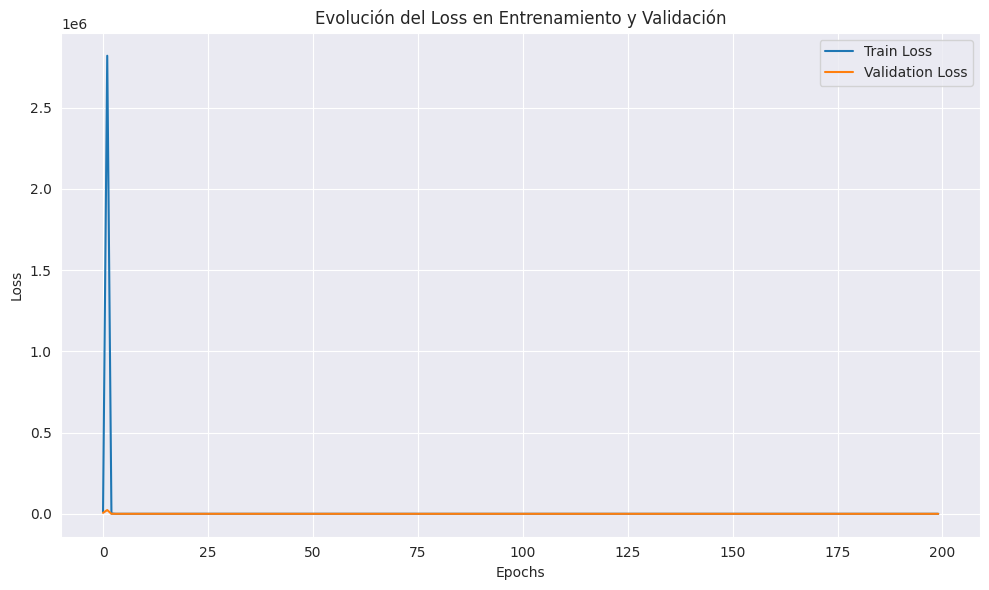

In [19]:
# Graficar las pérdidas de entrenamiento y validación
plt.figure(figsize=(10, 6))
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Evolución del Loss en Entrenamiento y Validación')
plt.tight_layout()
plt.show()

In [20]:
# Función para visualizar un piano roll
def visualize_piano_roll(piano_roll, title):
    plt.figure(figsize=(12, 4))
    plt.imshow(piano_roll.reshape(88, -1), aspect='auto', origin='lower')
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('MIDI Note')
    plt.colorbar(label='Velocity')
    plt.show()

In [23]:
model.eval()
with torch.inference_mode():
    sample = next(iter(train_loader))[0]
    sample = sample.to(device)
    reconstructed, _, _ = model(sample.reshape(1, 2200))
    original = sample.cpu().numpy()
    reconstructed = reconstructed.cpu().numpy()

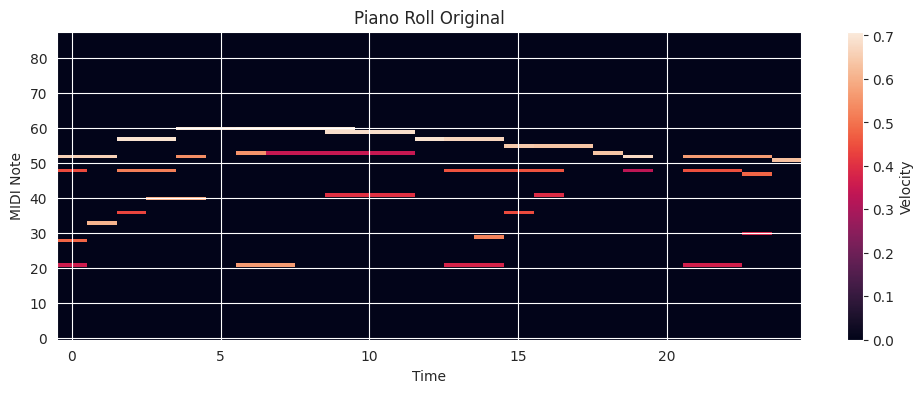

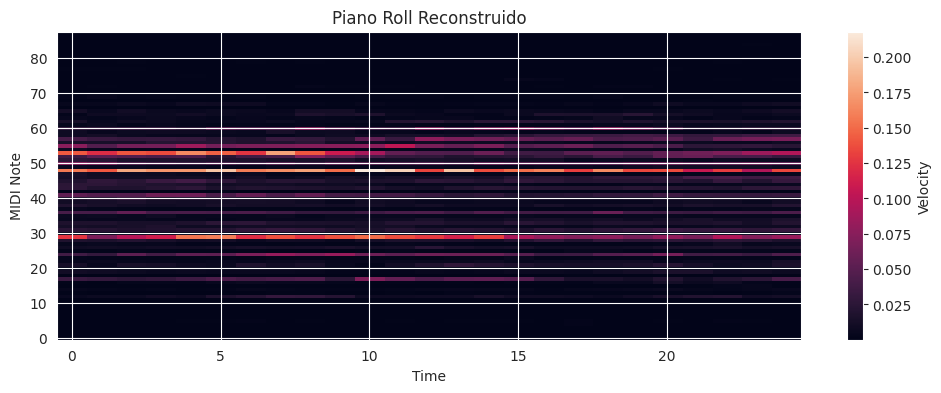

In [24]:
visualize_piano_roll(sample.cpu(), 'Piano Roll Original')
visualize_piano_roll(reconstructed, 'Piano Roll Reconstruido')


In [25]:
reconstructed.reshape(88, -1)

array([[1.1129349e-03, 4.9960277e-06, 7.4884001e-06, ..., 5.7607072e-06,
        5.3251033e-06, 2.0336162e-04],
       [2.8313132e-05, 3.3987038e-05, 1.5493992e-05, ..., 4.5837269e-06,
        3.6163431e-06, 3.1508887e-04],
       [3.1950472e-05, 3.6952013e-05, 7.7801415e-05, ..., 2.7318052e-05,
        2.7595654e-05, 1.4775108e-04],
       ...,
       [5.8702885e-06, 5.1023785e-06, 6.9607695e-06, ..., 5.5660057e-06,
        5.2066366e-06, 5.3585677e-06],
       [5.3727417e-06, 5.8180553e-06, 6.6685129e-06, ..., 5.6575395e-06,
        5.7751413e-06, 5.4910124e-06],
       [7.6443139e-06, 5.8485512e-06, 6.1509340e-06, ..., 5.9790736e-06,
        5.7360380e-06, 5.2572104e-06]], dtype=float32)

In [26]:
reconstructed.min()

np.float32(9.2496595e-07)

In [27]:
reconstructed.max()

np.float32(0.2180222)

In [176]:
pd.DataFrame(reconstructed.reshape(88, -1))[40:50]

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
40,0.246530,0.248151,0.246704,0.224262,0.206385,0.210927,0.184683,0.241566,0.225401,0.237696,...,0.276913,0.271766,0.243485,0.252818,0.241700,0.249090,0.243236,0.244373,0.237276,0.211712
41,0.276061,0.243279,0.235149,0.246391,0.255035,0.235879,0.261023,0.262819,0.263716,0.258227,...,0.266546,0.254853,0.258035,0.241160,0.278858,0.278602,0.276518,0.261435,0.281531,0.259839
42,0.240881,0.252275,0.279770,0.254943,0.256566,0.261265,0.245791,0.269223,0.261416,0.275337,...,0.241074,0.215420,0.255887,0.232507,0.216106,0.237592,0.244188,0.259718,0.243521,0.221792
43,0.284843,0.271403,0.286889,0.242850,0.246411,0.244855,0.265982,0.257154,0.244609,0.250088,...,0.252131,0.254422,0.262547,0.237447,0.261806,0.279149,0.258942,0.252181,0.260159,0.259651
44,0.279312,0.271839,0.291428,0.281654,0.254950,0.264777,0.254682,0.249959,0.253133,0.271452,...,0.260160,0.257291,0.250205,0.259561,0.268312,0.265256,0.306538,0.261704,0.274695,0.291022
45,0.221299,0.245673,0.235571,0.223347,0.235863,0.253129,0.213975,0.213834,0.209777,0.201261,...,0.225152,0.226006,0.240147,0.235379,0.243330,0.266890,0.234274,0.253265,0.211255,0.226299
46,0.294772,0.297512,0.264587,0.258686,0.301296,0.275932,0.256872,0.284737,0.290962,0.282694,...,0.293641,0.268427,0.251296,0.294230,0.259360,0.260677,0.262023,0.280834,0.263476,0.235284
47,0.291633,0.249836,0.248549,0.280373,0.291500,0.281203,0.242819,0.256107,0.260863,0.261908,...,0.266790,0.260656,0.264048,0.282420,0.290683,0.248468,0.238097,0.267973,0.246328,0.244473
48,0.261560,0.253849,0.269821,0.248424,0.267144,0.275395,0.274066,0.266538,0.259255,0.257894,...,0.268641,0.259941,0.264931,0.248757,0.270075,0.256505,0.276030,0.266118,0.247914,0.274209
49,0.292375,0.288865,0.263573,0.284149,0.296292,0.289879,0.288006,0.304089,0.312965,0.306653,...,0.310757,0.278016,0.294837,0.294938,0.273873,0.274550,0.277033,0.280490,0.294552,0.291368


In [28]:
# Vamos a multiplicar los valores del reconstucted por 5, y lo que esta abajo de 0.1 lo vamos a poner en 0
reconstructed = reconstructed * 5
reconstructed[reconstructed < 0.1] = 0

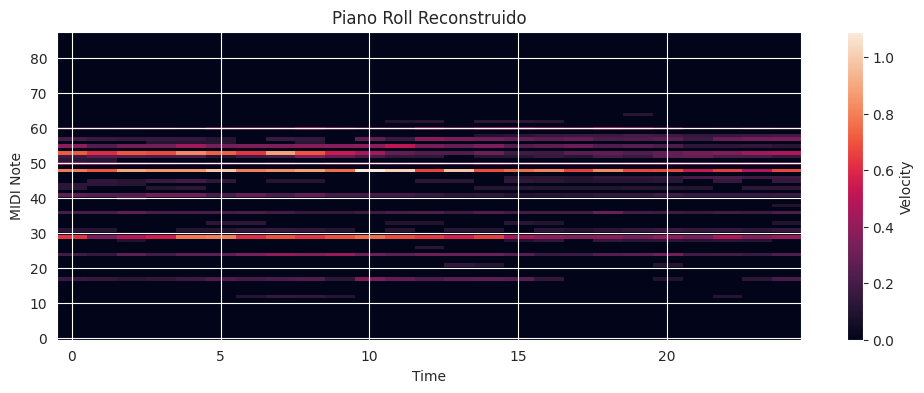

In [29]:
visualize_piano_roll(reconstructed, 'Piano Roll Reconstruido')

In [32]:
def piano_roll_to_midi(piano_roll, fs=5, output_path='output.mid'):
    """
    Convierte un piano roll a un archivo MIDI.
    """
    midi_data = pretty_midi.PrettyMIDI()
    instrument = pretty_midi.Instrument(program=0)  # Instrumento piano

    # Para cada nota en el rango del piano (88 notas)
    for note_index in range(piano_roll.shape[0]):
        # Encontrar los intervalos donde la nota está activa
        note_events = np.where(piano_roll[note_index, :] > 0)[0]

        if len(note_events) == 0:
            continue

        # Agrupar las activaciones de notas en eventos de nota continua
        current_note_start = note_events[0]
        for i in range(1, len(note_events)):
            if note_events[i] != note_events[i - 1] + 1:
                # Finalizar la nota anterior y comenzar una nueva
                note = pretty_midi.Note(
                    velocity=int(piano_roll[note_index, current_note_start] * 127),
                    pitch=note_index + 21,  # 21 es A0
                    start=current_note_start / fs,
                    end=note_events[i - 1] / fs
                )
                instrument.notes.append(note)
                current_note_start = note_events[i]

        # Añadir la última nota
        note = pretty_midi.Note(
            velocity=int(piano_roll[note_index, current_note_start] * 127),
            pitch=note_index + 21,  # 21 es A0
            start=current_note_start / fs,
            end=note_events[-1] / fs
        )
        instrument.notes.append(note)

    midi_data.instruments.append(instrument)
    midi_data.write(output_path)
    print(f"Archivo MIDI guardado en {output_path}")

In [38]:
original_name = "var_train_original"
reconstructed_name = "var_train_reconstructed"

# Convertir la primera muestra de piano roll a MIDI
piano_roll_to_midi(original.reshape(88, -1), fs=5, output_path=f"output/{original_name}.midi")
piano_roll_to_midi(reconstructed.reshape(88, -1), fs=5, output_path=f"output/{reconstructed_name}.midi")

Archivo MIDI guardado en output/var_train_original.midi
Archivo MIDI guardado en output/var_train_reconstructed.midi


In [39]:
# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{original_name}.midi -Ow -o output/{original_name}.wav")

# Reproducir el archivo WAV
display(Audio(f"output/{original_name}.wav"))

# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{reconstructed_name}.midi -Ow -o output/{reconstructed_name}.wav")

# Reproducir el archivo WAV
display(Audio(f"output/{reconstructed_name}.wav"))

Playing output/var_train_original.midi
MIDI file: output/var_train_original.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


Playing output/var_train_reconstructed.midi
MIDI file: output/var_train_reconstructed.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


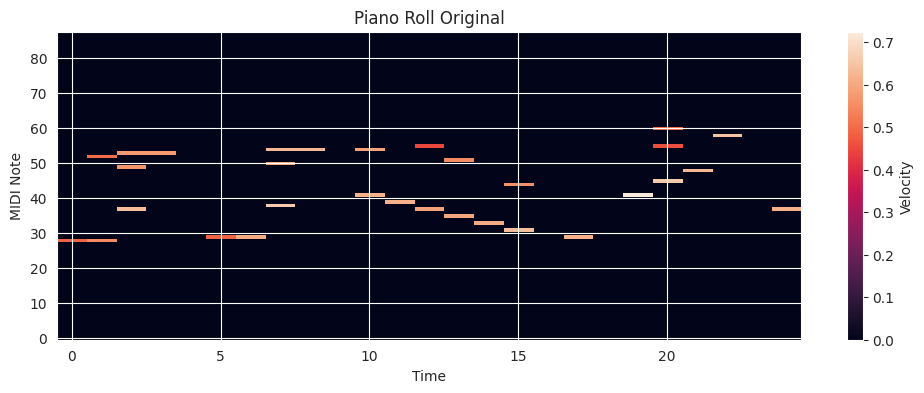

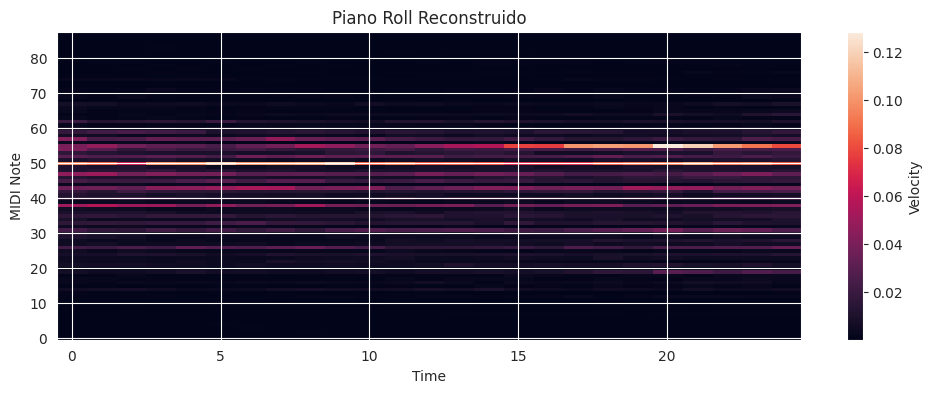

In [53]:
model.eval()
with torch.inference_mode():
    sample = next(iter(val_loader))[0]
    sample = sample.to(device)
    reconstructed, _, _ = model(sample.reshape(1, 2200))
    original = sample.cpu().numpy()
    reconstructed = reconstructed.cpu().numpy()
visualize_piano_roll(sample.cpu(), 'Piano Roll Original')
visualize_piano_roll(reconstructed, 'Piano Roll Reconstruido')

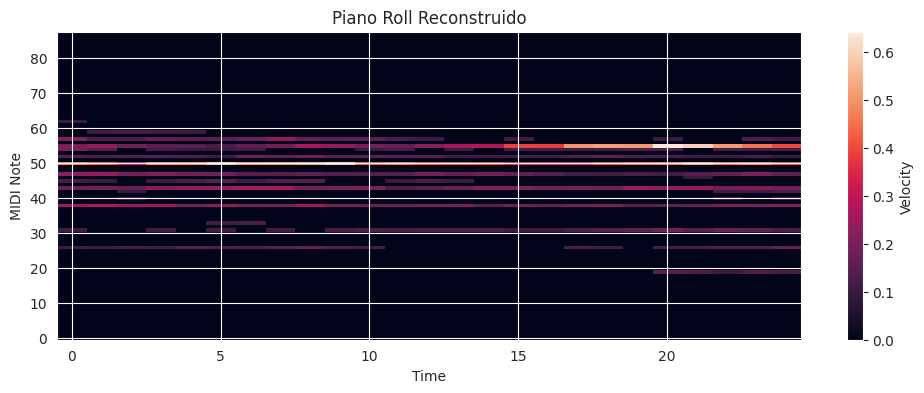

In [54]:
# Vamos a multiplicar los valores del reconstucted por 5, y lo que esta abajo de 0.1 lo vamos a poner en 0
reconstructed = reconstructed * 5
reconstructed[reconstructed < 0.1] = 0
visualize_piano_roll(reconstructed, 'Piano Roll Reconstruido')

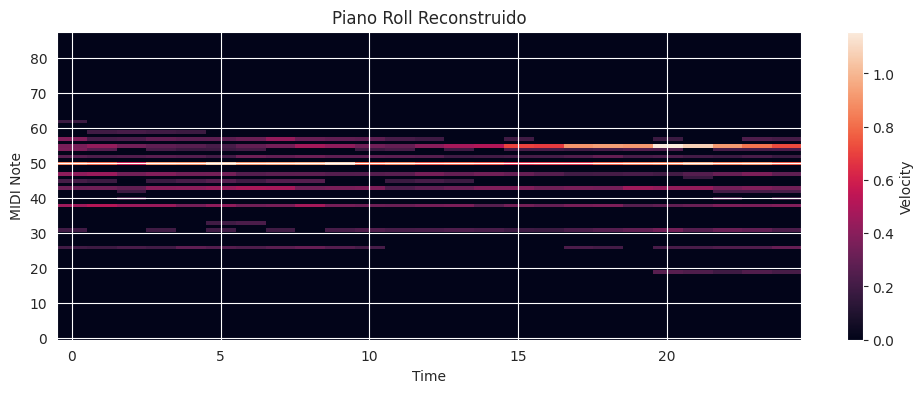

In [55]:
# Amplificamos un poco las notas
reconstructed = reconstructed * 1.8
visualize_piano_roll(reconstructed, 'Piano Roll Reconstruido')

In [56]:
original_name = "var_val_original"
reconstructed_name = "var_val_reconstructed"

# Convertir la primera muestra de piano roll a MIDI
piano_roll_to_midi(original.reshape(88, -1), fs=5, output_path=f"output/{original_name}.midi")
piano_roll_to_midi(reconstructed.reshape(88, -1), fs=5, output_path=f"output/{reconstructed_name}.midi")
# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{original_name}.midi -Ow -o output/{original_name}.wav")

# Reproducir el archivo WAV
display(Audio(f"output/{original_name}.wav"))

# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{reconstructed_name}.midi -Ow -o output/{reconstructed_name}.wav")

# Reproducir el archivo WAV
display(Audio(f"output/{reconstructed_name}.wav"))

Archivo MIDI guardado en output/var_val_original.midi
Archivo MIDI guardado en output/var_val_reconstructed.midi
Playing output/var_val_original.midi
MIDI file: output/var_val_original.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


Playing output/var_val_reconstructed.midi
MIDI file: output/var_val_reconstructed.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


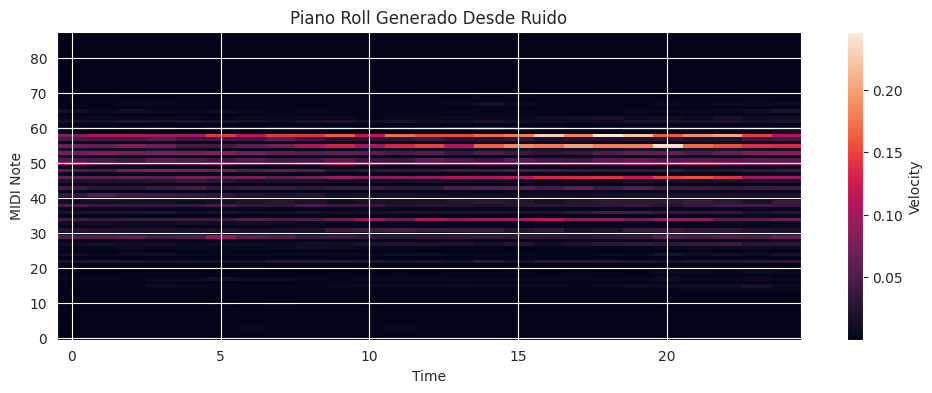

In [57]:
# Generar un vector de ruido (muestreado de una distribución normal estándar)
random_noise = torch.randn(1, latent_size).to(device)  # Un solo vector de ruido

# Generar la reconstrucción a partir del ruido con el decoder
with torch.inference_mode():
    generated_piano_roll = model.decoder(random_noise)

# Transformar la salida para visualizarla (reshape al formato de piano roll)
generated_piano_roll = generated_piano_roll.cpu().numpy().reshape(88, -1)  # Asegúrate de que el tamaño coincida con tu piano roll

# Visualizar el piano roll generado
visualize_piano_roll(generated_piano_roll, 'Piano Roll Generado Desde Ruido')


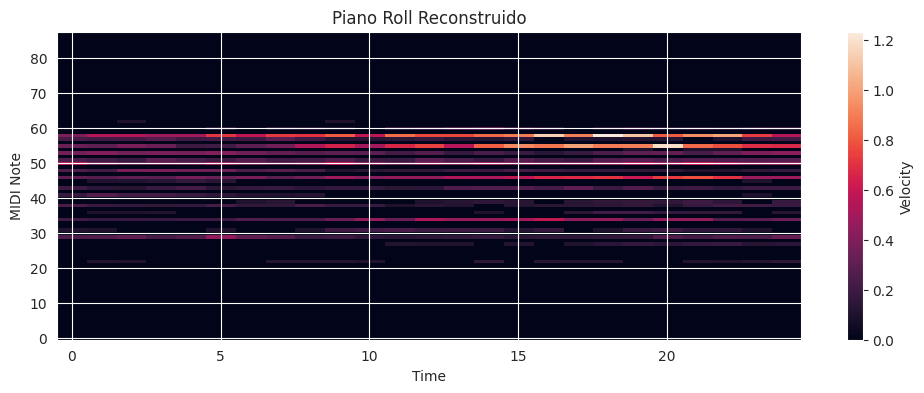

In [58]:
# Vamos a multiplicar los valores del reconstucted por 5, y lo que esta abajo de 0.1 lo vamos a poner en 0
generated_piano_roll = generated_piano_roll * 5
generated_piano_roll[generated_piano_roll < 0.1] = 0
visualize_piano_roll(generated_piano_roll, 'Piano Roll Reconstruido')

In [59]:
reconstructed_name = "var_noise_reconstructed"

# Convertir la primera muestra de piano roll a MIDI
piano_roll_to_midi(reconstructed.reshape(88, -1), fs=5, output_path=f"output/{reconstructed_name}.midi")

# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{reconstructed_name}.midi -Ow -o output/{reconstructed_name}.wav")

# Reproducir el archivo WAV
display(Audio(f"output/{reconstructed_name}.wav"))

Archivo MIDI guardado en output/var_noise_reconstructed.midi
Playing output/var_noise_reconstructed.midi
MIDI file: output/var_noise_reconstructed.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0


torch.Size([1, 256])


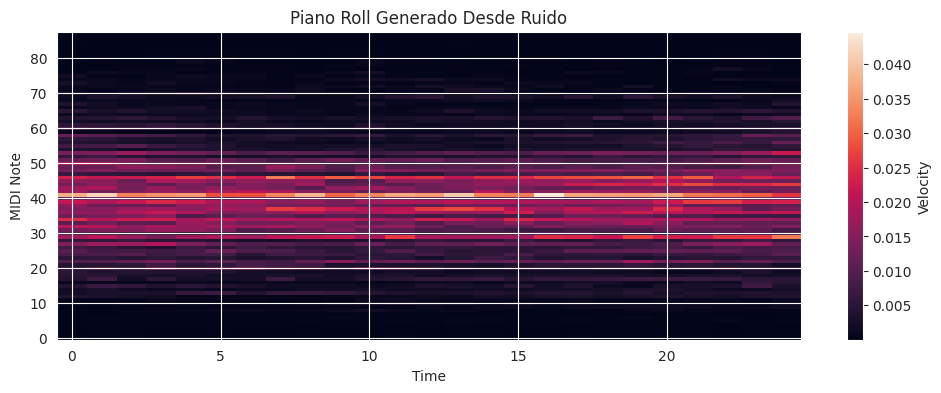

In [74]:
# Generar un vector de ruido (muestreado de una distribución normal estándar)
random_noise = torch.Tensor([np.random.rand(latent_size)]).to(device)
print(random_noise.shape)

# Generar la reconstrucción a partir del ruido con el decoder
with torch.inference_mode():
    generated_piano_roll = model.decoder(random_noise)

# Transformar la salida para visualizarla (reshape al formato de piano roll)
generated_piano_roll = generated_piano_roll.cpu().numpy().reshape(88, -1)  # Asegúrate de que el tamaño coincida con tu piano roll

# Visualizar el piano roll generado
visualize_piano_roll(generated_piano_roll, 'Piano Roll Generado Desde Ruido')


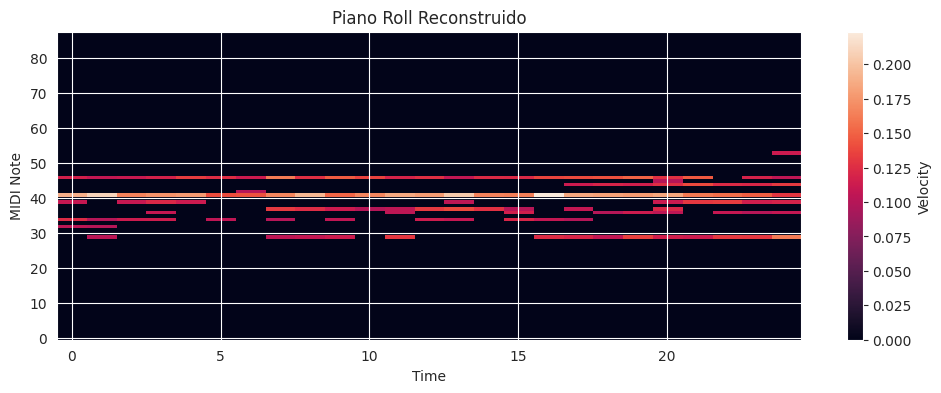

In [75]:
# Vamos a multiplicar los valores del reconstucted por 5, y lo que esta abajo de 0.1 lo vamos a poner en 0
generated_piano_roll = generated_piano_roll * 5
generated_piano_roll[generated_piano_roll < 0.1] = 0
visualize_piano_roll(generated_piano_roll, 'Piano Roll Reconstruido')

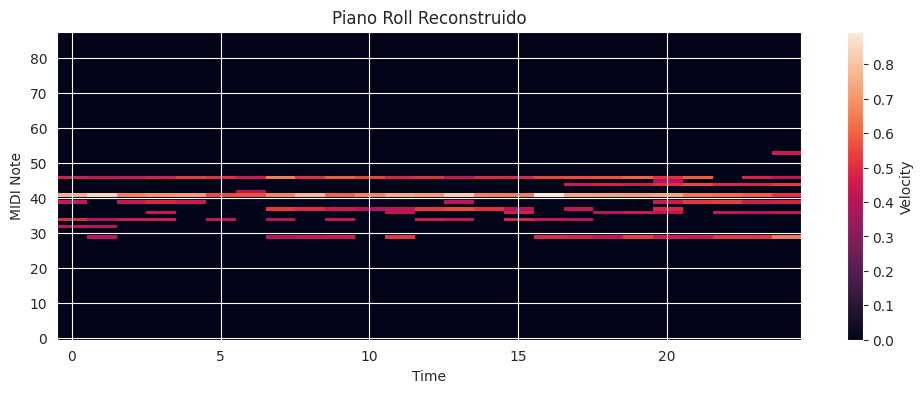

In [76]:
generated_piano_roll = generated_piano_roll * 4
visualize_piano_roll(generated_piano_roll, 'Piano Roll Reconstruido')

In [77]:
reconstructed_name = "var_noise_2_reconstructed"

# Convertir la primera muestra de piano roll a MIDI
piano_roll_to_midi(reconstructed.reshape(88, -1), fs=5, output_path=f"output/{reconstructed_name}.midi")

# Reproducirlo, primero instalar timidity en el sistema
os.system(f"timidity output/{reconstructed_name}.midi -Ow -o output/{reconstructed_name}.wav")

# Reproducir el archivo WAV
display(Audio(f"output/{reconstructed_name}.wav"))

Archivo MIDI guardado en output/var_noise_2_reconstructed.midi
Playing output/var_noise_2_reconstructed.midi
MIDI file: output/var_noise_2_reconstructed.midi
Format: 1  Tracks: 2  Divisions: 220
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0
